In [1]:
import os
import pandas as pd
import matplotlib.pyplot as plt
from IPython.display import HTML
from skimage.metrics import structural_similarity as ssim
from matplotlib.animation import ArtistAnimation
import matplotlib.animation as animation
%matplotlib inline

import cv2


In [2]:
meta = pd.read_json("./metadata.json").transpose()
meta.head()

,label,split,original
gthvvygfcj.mp4,FAKE,train,lxeqbyddvt.mp4
yunqitmhjo.mp4,FAKE,train,hbrgvmrtnn.mp4
mwizcjywkd.mp4,FAKE,train,stdavraahk.mp4
ymswdhnnyp.mp4,FAKE,train,gwzttezkpv.mp4
lsfsintfky.mp4,FAKE,train,xrtmepdfyh.mp4


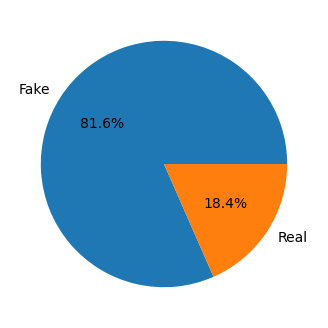

We have a skewed dataset with mostly fake videos.


In [3]:
labels = 'Fake', 'Real'
sizes = [meta[meta.label == 'FAKE'].label.count(), meta[meta.label == 'REAL'].label.count()]

plt.figure(figsize=(5, 4))
plt.pie(sizes, labels=labels, autopct='%1.1f%%')
# plt.title('Data Proportion')
# plt.savefig("./static/images/data_prop.png", bbox_inches='tight', transparent=True, dpi=300)
plt.show()
print("We have a skewed dataset with mostly fake videos.")

### Let us look at a few frames from fake and real videos 

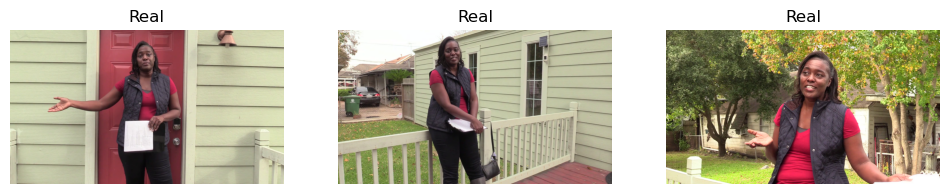

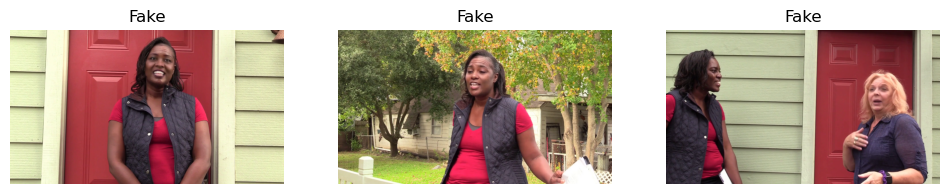

In [4]:
ROOT = "./dfdc_train_part_45/"

def get_frames(filename, num_frames):
	frames = []
	video = cv2.VideoCapture(filename)
	for _ in range(num_frames):
		ret, frame = video.read()
		frames.append(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
	video.release()
	return frames

# show real frames
reals = meta[meta["label"] == "REAL"].index
fig = plt.figure(figsize=(12, 8))
for i in range(3):
	fig.add_subplot(1, 3, i + 1) 
	file = reals[i]
	frame = get_frames(ROOT + file, 1)[0]
	plt.imshow(frame)
	plt.title("Real")
	plt.axis("off")
# plt.savefig("./static/images/reals.png", bbox_inches='tight', transparent=True, dpi=300)
plt.show()

# show fake frames
fakes = meta[meta["label"] == "FAKE"].index
fig = plt.figure(figsize=(12, 12))
for i in range(3):
	fig.add_subplot(1, 3, i + 1) 
	file = fakes[i]
	frame = get_frames(ROOT + file, 1)[0]
	plt.imshow(frame)
	plt.title("Fake")
	plt.axis("off")
# plt.savefig("./static/images/fakes.png", bbox_inches='tight', transparent=True, dpi=300)
plt.show()

### Single frames may not give us the most information. Let us take a look at a few frames in an animated form

In [5]:
real = "./dfdc_train_part_45/iovjcaptmz.mp4"
fake = "./dfdc_train_part_45/aaeucwtkdx.mp4"

In [6]:
frames = get_frames(fake, num_frames=50)
fig, ax = plt.subplots()
fig.set_size_inches(5, 2.8)
fig.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=None, hspace=None)
plt.axis("off")
ims = []
for frame in frames:
	im = ax.imshow(frame, animated=True)
	ims.append([im])

plt.close()
print("FAKE VIDEO")
anim = ArtistAnimation(fig, ims, interval=50, blit=True)
# FFwriter = animation.FFMpegWriter(fps=20)
# anim.save('./static/videos/fake.mp4', writer=FFwriter)
HTML(anim.to_jshtml())

FAKE VIDEO


In [7]:
frames = get_frames(real, num_frames=50)
fig, ax = plt.subplots()
fig.set_size_inches(5, 2.8)
fig.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=None, hspace=None)
plt.axis("off")
ims = []
for frame in frames:
	im = ax.imshow(frame, animated=True)
	ims.append([im])

plt.close()

print("REAL VIDEO")
anim = ArtistAnimation(fig, ims, interval=50, blit=True)
# FFwriter = animation.FFMpegWriter(fps=20)
# anim.save('./static/videos/real.mp4', writer=FFwriter)
HTML(anim.to_jshtml())

REAL VIDEO


Animation size has reached 21220168 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


### AI models struggle to get the face of a person correct, so let us zoom in and see if we can identify some unusual artifacts

In [8]:
def visualize_frame(filename):
	image = get_frames(filename, 1)[0]
	fig, axs = plt.subplots(1, 2, figsize=(10, 4))
	
	face_cascade = cv2.CascadeClassifier('./haarcascade_frontalface_default.xml')
	faces = face_cascade.detectMultiScale(image, 1.3, 5)
	image_with_detections = image.copy()
	
	for (x,y,w,h) in faces:
		cv2.rectangle(image_with_detections, (x, y), (x + w, y + h), (255, 0, 0), 3)
	axs[0].imshow(image_with_detections)
	axs[0].axis('off')
	axs[0].set_title('Highlight faces')
	
	crop_img = image.copy()
	for (x, y, w, h) in faces:
		crop_img = image[y:y+h, x:x+w]
		break
	axs[1].imshow(crop_img)
	axs[1].axis('off')
	axs[1].set_title('Zoom-in face')
	plt.show()

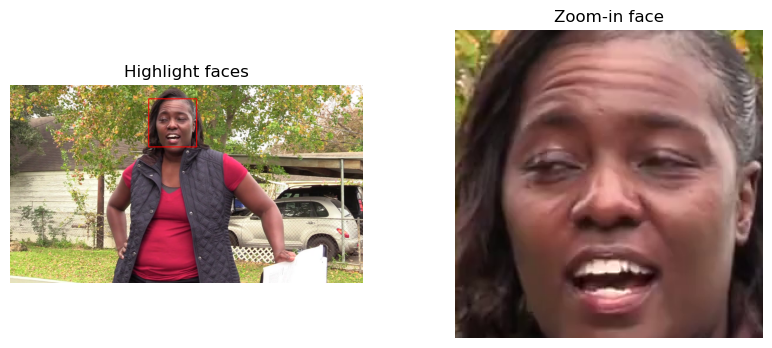

In [9]:
visualize_frame(real)

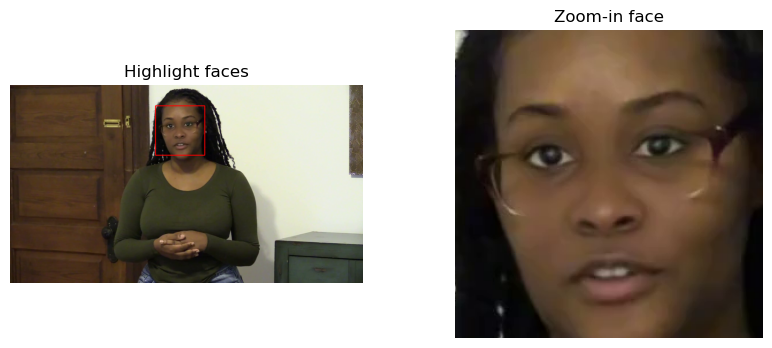

In [10]:
visualize_frame(fake)

### Let us see how the face looks across frames. AI will most likely struggle to maintain consistency here

In [11]:
def get_ssim_scores(frames):
	scores = []
	for i in range(len(frames) - 1):
		score, diff = ssim(frames[i], frames[i + 1], full=True, channel_axis=2)
		scores.append(score)
	return scores

def zoomed_frames(filename, num_frames, real):
	images = get_frames(filename, num_frames)
	
	face_cascade = cv2.CascadeClassifier('./haarcascade_frontalface_default.xml')
	fig, ax = plt.subplots()
	plt.axis("off")
	ims = []
	frames = []
	for image in images:
		faces = face_cascade.detectMultiScale(image, 1.3, 5)
		for (x, y, w, h) in faces:
			im = ax.imshow(image[y:y+h, x:x+w], animated=True)
			frames.append(image[y:y+h, x:x+w])
			ims.append([im])
			break
	plt.close()
	anim = ArtistAnimation(fig, ims, interval=50, blit=True)
	FFwriter = animation.FFMpegWriter(fps=20)
	# if real:
	# 	anim.save('./static/videos/real_face.mp4', writer=FFwriter)
	# else:
	# 	anim.save('./static/videos/fake_face.mp4', writer=FFwriter)
	return get_ssim_scores(images)

In [12]:
real_scores = zoomed_frames(real, 60, True)
fake_scores = zoomed_frames(fake, 60, False)

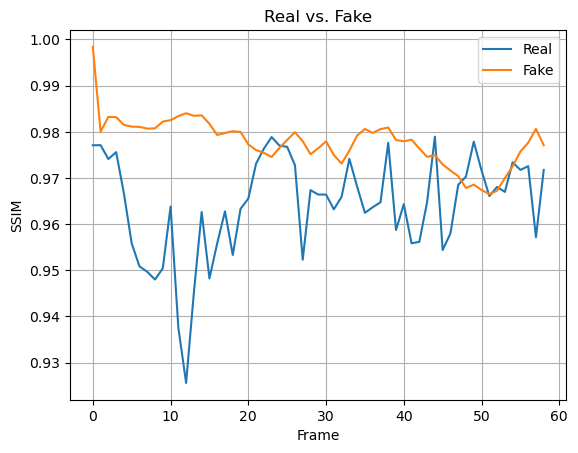

In [13]:
plt.plot(real_scores, label="Real")
plt.plot(fake_scores, label="Fake")
plt.title("Real vs. Fake")
plt.xlabel("Frame")
plt.ylabel("SSIM")
plt.grid("off")
plt.legend()
# plt.savefig("./static/images/ssim.png", bbox_inches='tight', transparent=True, dpi=300)
plt.show()